In [25]:
import joblib
import pandas as pd
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
import lightgbm as lgb
from datetime import datetime
from catboost import CatBoostRegressor
import numpy as np
from sklearn.model_selection import KFold
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from scipy.stats import randint as sp_randint
from sklearn.model_selection import RandomizedSearchCV,GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
import matplotlib.pyplot as plt
from scipy.stats import uniform, randint
from lightgbm import LGBMRegressor
import plotly.graph_objs as go

## Importing Data


In [26]:
train_data = pd.read_csv("data/train.csv")
test_data = pd.read_csv("data/test.csv")
val_data = pd.read_csv("data/val.csv")

In [27]:
train_data.T

,0,1,2,3,4,5,6,7,8,9,...,38390,38391,38392,38393,38394,38395,38396,38397,38398,38399
reservation_id,af59a353354e1f770f74dfded465188551eecfa178fa14...,f181967e96e4384c4602e83972cf599be88086c147fafc...,5bc545fffdf66fd7b6da6e63711df565721542b145d5da...,ae726f5288bcd1a4c94d717ec767fbd73413ef24bcae92...,22591667173e9ba038376579f5750965a3a439304985ce...,22a2111d19d4abfbfab8a65cc1f81e52db09e096a6511a...,91815eb6f8859e680cbc786d6f018567383d3fd8162e7e...,40cbf74d4e2457f46029b45715b3812349964172bf7407...,9d72d3972f0a334ca8aaebb89025e20f746ab6b8bf97ea...,45172b19870e988ce09f83f4c0a79a100cacff6f06d88e...,...,f06bb907fdce3cfe250c2e2cfddb5a79639309e9ae5553...,57885d67c8b71b62bfbe5bd30488fe04dc673e52b18b44...,6b3a004512d7d2e702562afcaf9c45257e4b813aabd15d...,036ef2fad7c0ae76f070b68cc51c84b933b9e31f9452cf...,9364d569e9149dfec61fd29218edd4fe318c90f894cf50...,05a9ddd2d3b3865aee948409bec362186e219a32f0cc1d...,3e4cd47769c1e3b6b309fe9a3b6ef5844d75ecd328af59...,50ff4b7deb119747684dfa13e09a340b93a314c3a2b34a...,5a396595b2ed3eeb4448a240c230a0d9c718813a91776c...,a9b5a33fb9052315259763e6563cba6826ff008eb3f1b0...
booking_date,26/04/18,03/10/18,01/01/17,30/05/17,08/01/15,16/10/14,04/02/17,09/09/17,19/01/17,12/09/17,...,04/01/18,23/03/17,22/05/17,21/07/18,30/07/15,06/05/15,12/02/18,06/09/18,01/08/16,18/12/16
checkin_date,01/06/18,19/10/18,11/04/17,31/05/17,19/03/15,01/01/15,30/04/17,26/11/17,03/04/17,12/10/17,...,20/04/18,13/05/17,22/05/17,06/08/18,04/09/15,11/05/15,06/04/18,04/12/18,13/11/16,05/01/17
checkout_date,05/06/18,20/10/18,15/04/17,01/06/17,21/03/15,04/01/15,05/05/17,01/12/17,05/04/17,15/10/17,...,22/04/18,15/05/17,23/05/17,09/08/18,06/09/15,13/05/15,07/04/18,06/12/18,16/11/16,08/01/17
channel_code,2,1,1,1,3,1,1,1,1,2,...,1,1,3,1,3,3,2,1,1,1
main_product_code,2,1,1,2,3,1,2,1,2,1,...,2,2,2,2,4,2,3,3,2,1
numberofadults,4,3,4,2,3,4,2,6,2,2,...,2,5,3,2,3,4,2,2,4,2
numberofchildren,4,0,0,0,0,2,2,0,0,1,...,2,1,0,0,0,0,0,0,0,0
persontravellingid,4752,45,45,45,45,45,45,45,47,45,...,45,45,45,45,46,45,45,4752,45,45
resort_region_code,1,3,1,1,1,2,1,1,2,3,...,3,2,1,1,1,3,1,2,2,3


In [28]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 38400 entries, 0 to 38399
Data columns (total 24 columns):
 #   Column                              Non-Null Count  Dtype  
---  ------                              --------------  -----  
 0   reservation_id                      38400 non-null  object 
 1   booking_date                        38400 non-null  object 
 2   checkin_date                        38400 non-null  object 
 3   checkout_date                       38400 non-null  object 
 4   channel_code                        38400 non-null  int64  
 5   main_product_code                   38400 non-null  int64  
 6   numberofadults                      38400 non-null  int64  
 7   numberofchildren                    38400 non-null  int64  
 8   persontravellingid                  38400 non-null  int64  
 9   resort_region_code                  38400 non-null  int64  
 10  resort_type_code                    38400 non-null  int64  
 11  room_type_booked_code               38400

## Converting dates columns into datetime data type

In [29]:
def convert_datetime(df):
    df["checkin_date"] = pd.to_datetime(df['checkin_date'])
    df["checkout_date"] = pd.to_datetime(df['checkout_date'])
    df["booking_date"] = pd.to_datetime(df['booking_date'])
    return df

train_data= convert_datetime(train_data)
test_data= convert_datetime(test_data)
val_data= convert_datetime(val_data)

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2227079341.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2227079341.py:3: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2227079341.py:4: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2227079341.py:2: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a f

In [30]:
val_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9600 entries, 0 to 9599
Data columns (total 24 columns):
 #   Column                              Non-Null Count  Dtype         
---  ------                              --------------  -----         
 0   reservation_id                      9600 non-null   object        
 1   booking_date                        9600 non-null   datetime64[ns]
 2   checkin_date                        9600 non-null   datetime64[ns]
 3   checkout_date                       9600 non-null   datetime64[ns]
 4   channel_code                        9600 non-null   int64         
 5   main_product_code                   9600 non-null   int64         
 6   numberofadults                      9600 non-null   int64         
 7   numberofchildren                    9600 non-null   int64         
 8   persontravellingid                  9600 non-null   int64         
 9   resort_region_code                  9600 non-null   int64         
 10  resort_type_code        

## Making a copy of a data

In [31]:
temp_train = train_data.copy()
temp_test = test_data.copy()
temp_val = val_data.copy()

## Formation based on date

makeing new columns using checkin, checkout and booking dates

1. checkin week :- Week of the Checkin data
2. checkin month :- Month of the Checkin data
3. checkin year :- Year of the Checkin data
4. checkout month :- Month of the Checkout data
5. Advance booking :- Finding advance booking by subtracting checkin date with booking date
6. Days stayed :- Finding days stayed by subtracing checkout date with checkin date
7. Weekdays stayed :- To count total weekdays
8. Weekends stayed :- To count total weekends
9. Dropped days :- Total dropped days
10. Person days :- Total person days

In [32]:
def formation_based_on_date(df):

    # Check in week, month and year
    df["checkin_week"] = df['checkin_date'].dt.isocalendar().week
    df["checkin_month"] = df['checkin_date'].dt.month
    df["checkin_year"] = df['checkin_date'].dt.year

    # Checkout week and month
    df["checkout_week"] = df['checkout_date'].dt.isocalendar().week
    df["checkout_month"] = df['checkout_date'].dt.month

    # Advance booking and days stayed
    df["advance_booking"] = (df['checkin_date'] - df["booking_date"]).dt.days
    df["days_stayed"] = (df['checkout_date'] - df['checkin_date']).dt.days

    # To count total weekdays
    df["weekdays_stayed"] = np.busday_count(df['checkin_date'].values.astype('datetime64[D]'),
                                                df['checkout_date'].values.astype('datetime64[D]'))

    # To count total weekends
    df["weekends_stayed"] = df["days_stayed"] - df["weekdays_stayed"]

    # Total dropped days
    df["dropped_days"] = df["roomnights"] - df["days_stayed"]

    # Total person days
    df["total_pax_days"] = df['days_stayed'] * df['total_pax']


    return df

In [33]:
temp_train = formation_based_on_date(temp_train)
temp_test = formation_based_on_date(temp_test)
temp_val = formation_based_on_date(temp_val)

In [34]:
import pandas as pd
import plotly.graph_objs as go

# Count occurrences of each month
month_counts = temp_train['checkin_month'].value_counts().sort_index()

# Map month numbers to month names
month_names = {
    1: 'January',  2: 'February',  3: 'March',  4: 'April',  5: 'May',  6: 'June',
    7: 'July',  8: 'August',  9: 'September',  10: 'October',  11: 'November',  12: 'December'
}
month_labels = [month_names[month] for month in month_counts.index]

text_labels = month_counts.astype(str).tolist()

# Create a bar chart using Plotly
fig = go.Figure(data=go.Bar(
    x=month_labels,  
    y=month_counts.values,  
    text=text_labels,  
    textposition='outside',
    textfont=dict(
        family="sans serif",
        size=18,
        color="crimson"  # Change the color of the text labels here
    )
))

# Customize the figure
fig.update_layout(
    title='Checkins by Month',
    xaxis_title='Month',
    yaxis_title='Count',
    showlegend=False,
    height=600
)

# Display the figure
fig.show()


In [35]:
import pandas as pd
import plotly.graph_objs as go

# Assuming df is your DataFrame and it has a 'checkin_year' column
# Count occurrences of each year
year_counts = temp_train['checkin_year'].value_counts().sort_index()

# Create a bar chart using Plotly
text_labels = year_counts.astype(str).tolist()

# fig = go.Figure(data=go.Bar(x=year_counts.index, y=year_counts.values))
fig = go.Figure(data=go.Bar(x=year_counts.index, y=year_counts.values, text=text_labels, textposition='outside',textfont=dict(
                family="sans serif",
                size=18,
                color="crimson"  # Change the color of the text labels here
            )))


# Customize the figure
fig.update_layout(
    title='Checkins by Year',
    xaxis_title='Year',
    yaxis_title='Count',
    showlegend=False,
    height=600
)

# Display the figure
fig.show()


In [15]:
temp_train.T

,0,1,2,3,4,5,6,7,8,9,...,38390,38391,38392,38393,38394,38395,38396,38397,38398,38399
reservation_id,af59a353354e1f770f74dfded465188551eecfa178fa14...,f181967e96e4384c4602e83972cf599be88086c147fafc...,5bc545fffdf66fd7b6da6e63711df565721542b145d5da...,ae726f5288bcd1a4c94d717ec767fbd73413ef24bcae92...,22591667173e9ba038376579f5750965a3a439304985ce...,22a2111d19d4abfbfab8a65cc1f81e52db09e096a6511a...,91815eb6f8859e680cbc786d6f018567383d3fd8162e7e...,40cbf74d4e2457f46029b45715b3812349964172bf7407...,9d72d3972f0a334ca8aaebb89025e20f746ab6b8bf97ea...,45172b19870e988ce09f83f4c0a79a100cacff6f06d88e...,...,f06bb907fdce3cfe250c2e2cfddb5a79639309e9ae5553...,57885d67c8b71b62bfbe5bd30488fe04dc673e52b18b44...,6b3a004512d7d2e702562afcaf9c45257e4b813aabd15d...,036ef2fad7c0ae76f070b68cc51c84b933b9e31f9452cf...,9364d569e9149dfec61fd29218edd4fe318c90f894cf50...,05a9ddd2d3b3865aee948409bec362186e219a32f0cc1d...,3e4cd47769c1e3b6b309fe9a3b6ef5844d75ecd328af59...,50ff4b7deb119747684dfa13e09a340b93a314c3a2b34a...,5a396595b2ed3eeb4448a240c230a0d9c718813a91776c...,a9b5a33fb9052315259763e6563cba6826ff008eb3f1b0...
booking_date,2018-04-26 00:00:00,2018-03-10 00:00:00,2017-01-01 00:00:00,2017-05-30 00:00:00,2015-08-01 00:00:00,2014-10-16 00:00:00,2017-04-02 00:00:00,2017-09-09 00:00:00,2017-01-19 00:00:00,2017-12-09 00:00:00,...,2018-04-01 00:00:00,2017-03-23 00:00:00,2017-05-22 00:00:00,2018-07-21 00:00:00,2015-07-30 00:00:00,2015-06-05 00:00:00,2018-12-02 00:00:00,2018-06-09 00:00:00,2016-01-08 00:00:00,2016-12-18 00:00:00
checkin_date,2018-01-06 00:00:00,2018-10-19 00:00:00,2017-11-04 00:00:00,2017-05-31 00:00:00,2015-03-19 00:00:00,2015-01-01 00:00:00,2017-04-30 00:00:00,2017-11-26 00:00:00,2017-03-04 00:00:00,2017-12-10 00:00:00,...,2018-04-20 00:00:00,2017-05-13 00:00:00,2017-05-22 00:00:00,2018-06-08 00:00:00,2015-04-09 00:00:00,2015-11-05 00:00:00,2018-06-04 00:00:00,2018-04-12 00:00:00,2016-11-13 00:00:00,2017-05-01 00:00:00
checkout_date,2018-05-06 00:00:00,2018-10-20 00:00:00,2017-04-15 00:00:00,2017-01-06 00:00:00,2015-03-21 00:00:00,2015-04-01 00:00:00,2017-05-05 00:00:00,2017-01-12 00:00:00,2017-05-04 00:00:00,2017-10-15 00:00:00,...,2018-04-22 00:00:00,2017-05-15 00:00:00,2017-05-23 00:00:00,2018-09-08 00:00:00,2015-06-09 00:00:00,2015-05-13 00:00:00,2018-07-04 00:00:00,2018-06-12 00:00:00,2016-11-16 00:00:00,2017-08-01 00:00:00
channel_code,2,1,1,1,3,1,1,1,1,2,...,1,1,3,1,3,3,2,1,1,1
main_product_code,2,1,1,2,3,1,2,1,2,1,...,2,2,2,2,4,2,3,3,2,1
numberofadults,4,3,4,2,3,4,2,6,2,2,...,2,5,3,2,3,4,2,2,4,2
numberofchildren,4,0,0,0,0,2,2,0,0,1,...,2,1,0,0,0,0,0,0,0,0
persontravellingid,4752,45,45,45,45,45,45,45,47,45,...,45,45,45,45,46,45,45,4752,45,45
resort_region_code,1,3,1,1,1,2,1,1,2,3,...,3,2,1,1,1,3,1,2,2,3


In [16]:
temp_test.T

,0,1,2,3,4,5,6,7,8,9,...,11990,11991,11992,11993,11994,11995,11996,11997,11998,11999
reservation_id,f10db4056bd0fd104d07887e3f2610442e1ed4460a15a0...,10d7445a92746ef1d244f2d5c85ba4a7251c3aae9f91db...,68cfd1b097a5a14b3aeea85c54fa7f8d402a367167906a...,fbae42db0552db8b359dab6d6485e24eb07e9c8549f7a6...,348c49082448e0c51c4f3460ab8c7ace24c0f958da2c21...,430acd855c61e68db049fd26a01505c5c19c04ff7af16f...,456a76a0a16d3f885445c6953b7e1c610fbc928c07f816...,56ea6c36f9ecb5a890bdb29e3189a1031925e58b5f8fb8...,41b68e2f1a0cb96156d9713bd4f6d30a145e64b93b2467...,a9801776f38cf8768279873234aaaadfa5e8a5a8441c81...,...,99f29f5bdc5353f6e81ed9f2a9ff629230666b9facbe4d...,037093f64d1ca9ee7980557756bd63bb879e43c20f79e0...,487798e33ce1b82c6c9f54b80d9bbf91991cd44a5c8e28...,9d7c85ad643745910b3f3ed709c6974c2b3c155244d859...,74d4112cc5ce271c25d7b304be825ccb85e47bb7aa3c87...,e7f4aaa24919491c2d7ba3aca9a154b0fc8ca8f71df7bf...,636a1a2f6f356f753effa0084a5fdaca48e0d795acb50b...,0bb6e43be5e3869805caa28b78098df9298ca7e879792c...,09e4d4de4f1928bb1181570b7f283c6c6d81ef9316b0d5...,c6ad459c583abb12da0364d6c5475fb05be18aa9289ad8...
booking_date,2017-03-11 00:00:00,2018-12-07 00:00:00,2016-05-20 00:00:00,2016-12-16 00:00:00,2018-03-09 00:00:00,2017-02-02 00:00:00,2016-04-04 00:00:00,2015-04-29 00:00:00,2016-12-12 00:00:00,2017-01-18 00:00:00,...,2016-07-15 00:00:00,2017-04-14 00:00:00,2017-10-06 00:00:00,2017-07-10 00:00:00,2017-05-20 00:00:00,2016-03-17 00:00:00,2017-05-09 00:00:00,2017-10-19 00:00:00,2016-02-01 00:00:00,2018-04-23 00:00:00
checkin_date,2017-12-13 00:00:00,2018-07-27 00:00:00,2016-06-07 00:00:00,2017-09-01 00:00:00,2018-12-17 00:00:00,2017-05-31 00:00:00,2016-11-05 00:00:00,2015-12-07 00:00:00,2017-12-01 00:00:00,2017-11-03 00:00:00,...,2016-08-30 00:00:00,2017-05-22 00:00:00,2017-07-07 00:00:00,2017-10-27 00:00:00,2017-06-19 00:00:00,2016-05-14 00:00:00,2017-09-14 00:00:00,2017-12-19 00:00:00,2016-01-23 00:00:00,2018-04-23 00:00:00
checkout_date,2017-12-15 00:00:00,2018-07-29 00:00:00,2016-08-07 00:00:00,2017-01-13 00:00:00,2018-12-21 00:00:00,2017-04-06 00:00:00,2016-05-13 00:00:00,2015-07-16 00:00:00,2017-01-17 00:00:00,2017-12-03 00:00:00,...,2016-01-09 00:00:00,2017-05-26 00:00:00,2017-09-07 00:00:00,2017-10-30 00:00:00,2017-06-22 00:00:00,2016-05-17 00:00:00,2017-09-15 00:00:00,2017-12-23 00:00:00,2016-01-26 00:00:00,2018-04-24 00:00:00
channel_code,3,2,1,1,1,1,3,1,3,2,...,3,3,3,1,3,1,1,1,1,3
main_product_code,3,2,1,2,2,1,1,2,1,2,...,4,2,1,2,3,2,3,2,2,1
numberofadults,3,6,10,2,2,2,5,5,4,4,...,8,4,4,6,4,2,4,2,2,3
numberofchildren,0,3,0,2,0,2,0,0,0,0,...,2,0,0,0,0,0,0,0,2,0
persontravellingid,45,45,45,45,45,45,46,47,45,4752,...,45,46,46,45,45,45,45,45,45,45
resort_region_code,1,2,3,2,2,2,2,2,2,3,...,1,3,2,3,2,2,1,3,1,2


## Removing outliers

In [36]:
def remove_outliers(df):
    df = df.drop(df[df['roomnights'] < 0].index)
    df = df.drop(df[df['advance_booking'] < 0].index)
    df = df.drop(df[df['days_stayed'] < 0].index)
    df = df.drop(df[df['dropped_days'] < 0].index)
    df = df.drop(df[(df["numberofadults"] + df["numberofchildren"]) == 0].index)
    df = df.drop(df[df['total_pax'] == 0].index)

    return df


In [37]:
temp_test = remove_outliers(temp_test)
temp_train = remove_outliers(temp_train)
temp_val = remove_outliers(temp_val)

In [38]:
temp_train.T

,1,6,13,19,21,22,23,24,26,29,...,38380,38382,38383,38386,38387,38389,38390,38391,38392,38398
reservation_id,f181967e96e4384c4602e83972cf599be88086c147fafc...,91815eb6f8859e680cbc786d6f018567383d3fd8162e7e...,1382d6162ebe27cc0325aac433fde0b5f52231f064aa3d...,0de2d38ef35eb1a0c2d6777a397b055fd842505aecae33...,52036384b3e4a2b8011066ab2f74089d6db17f526b394c...,15f466e0e8db150b82d1deb9367a99cf886270bdb1c877...,5569f8e30c787e44015103f4b8689a9551ebd9ca6362d8...,c3d0057cce48412034c20fa644c870ce928370bc2960d8...,e2ed73c52fda9e4add668d4e0f0b9ab17df00bc835d824...,10df5230e577e4e29566c9ce254595af8aaf8103b786c9...,...,90a90035480acdc6cfaf2cc778139d6091ec982fc6b69d...,6066fbfc3b6eee86054f087ae44138d9744b36c8aee9ac...,9e1eea128781040cb26013d0aed410e5c939a453c12ce0...,20da6d900ae85c846295335cee032808cf0be6dbe47201...,3c290721a1c572d0b39d7a5869592efe1a604bd86eeed3...,37ba686e46f5792c50999221a02b32f8fc5c2e87596fc3...,f06bb907fdce3cfe250c2e2cfddb5a79639309e9ae5553...,57885d67c8b71b62bfbe5bd30488fe04dc673e52b18b44...,6b3a004512d7d2e702562afcaf9c45257e4b813aabd15d...,5a396595b2ed3eeb4448a240c230a0d9c718813a91776c...
booking_date,2018-03-10 00:00:00,2017-04-02 00:00:00,2017-09-25 00:00:00,2016-03-27 00:00:00,2016-12-29 00:00:00,2015-07-13 00:00:00,2018-04-17 00:00:00,2016-03-05 00:00:00,2018-05-06 00:00:00,2016-05-13 00:00:00,...,2017-01-11 00:00:00,2018-10-11 00:00:00,2017-04-13 00:00:00,2018-07-19 00:00:00,2018-11-20 00:00:00,2016-08-07 00:00:00,2018-04-01 00:00:00,2017-03-23 00:00:00,2017-05-22 00:00:00,2016-01-08 00:00:00
checkin_date,2018-10-19 00:00:00,2017-04-30 00:00:00,2017-10-21 00:00:00,2016-04-18 00:00:00,2017-02-13 00:00:00,2015-07-14 00:00:00,2018-05-25 00:00:00,2016-05-20 00:00:00,2018-06-22 00:00:00,2016-05-16 00:00:00,...,2018-02-16 00:00:00,2018-12-18 00:00:00,2017-06-14 00:00:00,2018-08-14 00:00:00,2019-02-13 00:00:00,2016-10-27 00:00:00,2018-04-20 00:00:00,2017-05-13 00:00:00,2017-05-22 00:00:00,2016-11-13 00:00:00
checkout_date,2018-10-20 00:00:00,2017-05-05 00:00:00,2017-10-23 00:00:00,2016-04-23 00:00:00,2017-02-15 00:00:00,2015-07-15 00:00:00,2018-05-26 00:00:00,2016-05-21 00:00:00,2018-06-24 00:00:00,2016-05-18 00:00:00,...,2018-02-19 00:00:00,2018-12-21 00:00:00,2017-06-19 00:00:00,2018-08-16 00:00:00,2019-02-18 00:00:00,2016-10-29 00:00:00,2018-04-22 00:00:00,2017-05-15 00:00:00,2017-05-23 00:00:00,2016-11-16 00:00:00
channel_code,1,1,2,1,3,1,1,3,3,1,...,2,2,1,3,3,3,1,1,3,1
main_product_code,1,2,1,2,3,1,2,2,4,2,...,3,2,2,2,4,2,2,2,2,2
numberofadults,3,2,3,2,3,2,4,3,4,4,...,3,2,2,4,6,2,2,5,3,4
numberofchildren,0,2,0,1,0,2,0,0,0,0,...,2,0,0,0,0,1,2,1,0,0
persontravellingid,45,45,45,45,45,47,45,45,45,45,...,47,45,45,45,45,45,45,45,45,45
resort_region_code,3,1,1,1,1,1,2,3,2,3,...,1,1,3,2,1,1,3,2,1,2


In [39]:
temp_train["days_stayed"].max()

14

## Formation based on groupby

In [40]:
def formation_based_on_groupby(df):

    calc_mean = df.groupby(['resort_id'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","advance_booking":"mean","total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['resort_id','totalpax_mean',"days_stayed_resmean","advance_booking_resmean","totpaxdays_resmean"]
    df = df.merge(calc_mean,on=['resort_id'],how='left')

    calc_mean = df.groupby(['memberid'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","advance_booking":"mean","reservation_id":"count",
         "roomnights":"mean","numberofadults":"mean","numberofchildren":"mean","weekends_stayed":"mean", "weekdays_stayed":"mean",
         "total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['memberid','totalpax_memmean',"days_stayed_memmean","advance_booking_memmean",
                         "res_memcnt","roomnights_memmean","adults_memmean","child_memmean","weekends_memmean","weekdays_memmean",
                         "totpaxdays_memmean"]
    df = df.merge(calc_mean,on=['memberid'],how='left')

    calc_mean = df.groupby(['memberid'], axis=0).agg(
        {"days_stayed":"sum","advance_booking":"sum","total_pax":"sum","numberofadults":"sum","numberofchildren":"sum",
         "weekends_stayed":"sum","total_pax_days":"sum"}).reset_index()
    calc_mean.columns = ['memberid',"days_stayed_memsum","advance_booking_memsum","total_pax_memsum","adults_memsum","child_memsum",
                         "weekend_memsum","totpaxdays_memsum"]
    df = df.merge(calc_mean,on=['memberid'],how='left')

    calc_mean = df.groupby(['memberid','resort_id'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","roomnights":"mean","reservation_id":"count","total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['memberid','resort_id','totalpax_memresmean',"days_stayed_memresmean","roomnights_memresmean",
                         "book_memrescnt","totpaxdays_memresmean"]
    df = df.merge(calc_mean,on=['memberid','resort_id'],how='left')

    df["passengers_dropped"] = df["total_pax"] - (df["numberofadults"] + df["numberofchildren"])

    drop = ['checkin_date','checkout_date','booking_date','memberid','reservation_id']
    df = df.drop(drop, axis=1)

    df = df.dropna()

    return df

In [41]:
temp_train = formation_based_on_groupby(temp_train)
temp_test = formation_based_on_groupby(temp_test)
temp_val = formation_based_on_groupby(temp_val)

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:3: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:8: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:17: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:24: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:3: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_39688\2738728996.py:8: FutureWarning:

The 'axis' keyword in Data

In [42]:
temp_train["days_stayed_resmean"].unique()

array([2.34064081, 2.39698965, 2.47759563, 2.54627072, 2.55813953,
       2.27777778, 2.50483559, 2.49844237, 2.34198113, 2.19240196,
       2.36785714, 2.61546392, 2.3040201 , 2.74137931, 2.19538188,
       2.15492958, 2.23880597, 2.75185185, 2.58744395, 2.04970009,
       2.24770642, 2.19862069, 2.5270936 , 2.39319471, 2.25396825,
       2.31643357, 2.57370518, 2.56375839, 2.39901478, 2.61616162,
       2.37454545, 2.08823529])

In [43]:
import plotly.graph_objs as go

# Count occurrences of each year
year_counts = temp_train['days_stayed_resmean'].value_counts()
print(len(year_counts))

# Create a horizontal bar chart using Plotly
text_labels = year_counts.astype(str).tolist()

fig = go.Figure(data=go.Bar(y=temp_train["resort_id"].unique(), x=temp_train["days_stayed_resmean"].unique(), orientation='h'))

# Customize the figure
fig.update_layout(
    title='mean days stayed for resort id',
    xaxis_title='Count',
    yaxis_title='Resort ID',
    showlegend=False,
    height=1000
)

# Display the figure
fig.show()

32


In [26]:
temp_train.isna().sum().any()

False

In [27]:
categorical_vars =temp_train.select_dtypes(include=['object']).columns.tolist()
categorical_vars

[]

## object to category

In [28]:
def object_to_category(df):

    categorical_vars =df.select_dtypes(include=['object']).columns.tolist()

    for i in categorical_vars:
            lbl = LabelEncoder()
            lbl.fit(list(df[i].values))
            df[i] = lbl.transform(list(df[i].values))

    for var in categorical_vars:
        df[var] = df[var].astype('category')

    return df

In [29]:
temp_val = object_to_category(temp_val)
temp_test = object_to_category(temp_test)
temp_train = object_to_category(temp_train)
temp_val.info()

<class 'pandas.core.frame.DataFrame'>
Index: 4253 entries, 0 to 4313
Data columns (total 57 columns):
 #   Column                              Non-Null Count  Dtype   
---  ------                              --------------  -----   
 0   channel_code                        4253 non-null   int64   
 1   main_product_code                   4253 non-null   int64   
 2   numberofadults                      4253 non-null   int64   
 3   numberofchildren                    4253 non-null   int64   
 4   persontravellingid                  4253 non-null   int64   
 5   resort_region_code                  4253 non-null   int64   
 6   resort_type_code                    4253 non-null   int64   
 7   room_type_booked_code               4253 non-null   int64   
 8   roomnights                          4253 non-null   int64   
 9   season_holidayed_code               4253 non-null   float64 
 10  state_code_residence                4253 non-null   float64 
 11  state_code_resort                  

In [30]:
temp_val.select_dtypes(include=['object']).columns.tolist()

[]

## Spliting the data into two parts features and labels

In [31]:
X = temp_train.drop(['amount_spent_per_room_night_scaled'], axis=1)
feature_set = X.columns
X = X.values
Y = temp_train['amount_spent_per_room_night_scaled'].values

In [32]:
X_val = temp_val.drop(['amount_spent_per_room_night_scaled'], axis=1)
val_feature_set = X_val.columns
X_val = X_val.values
Y_val = temp_val['amount_spent_per_room_night_scaled'].values

In [33]:
final_X_test = temp_test.drop(['amount_spent_per_room_night_scaled'], axis=1)
test_feature_set = final_X_test.columns
final_X_test = final_X_test.values
final_Y_test = temp_test['amount_spent_per_room_night_scaled'].values

## Chossing the models


### Temporarily spliting the data for choosing the model

In [34]:
X_train,X_test,Y_train,Y_test = train_test_split(X,Y, test_size=.2,random_state=42)

In [36]:
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LinearRegression, Ridge, Lasso, ElasticNet
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error
import numpy as np

# Define models
models = {
    "Linear Regression": LinearRegression(),
    "Ridge Regression": Ridge(),
    "Lasso Regression": Lasso(),
    "ElasticNet Regression": ElasticNet(),
    "Polynomial Regression": make_pipeline(PolynomialFeatures(degree=2), LinearRegression()),
    "Decision Tree Regression": DecisionTreeRegressor(),
    "Random Forest Regression": RandomForestRegressor(),
    "Gradient Boosting Regression": GradientBoostingRegressor(),
    "LightGBM Regression": LGBMRegressor(),
    "XGBoost Regression": XGBRegressor(),
    "CatBoost Regression": CatBoostRegressor(verbose=0)
}

# Perform regression for each model
for model_name, model in models.items():
    model.fit(X_train, Y_train)
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(Y_test, y_pred))
    print(f"{model_name} RMSE:", rmse)


Linear Regression RMSE: 1.0168182148956328
Ridge Regression RMSE: 1.0166008136770144
Lasso Regression RMSE: 1.0878464217324715
ElasticNet Regression RMSE: 1.0875190157730106
Polynomial Regression RMSE: 2.770721138307681
Decision Tree Regression RMSE: 1.4416384156831874
Random Forest Regression RMSE: 1.0259470946522944
Gradient Boosting Regression RMSE: 0.989595428627297
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001709 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1877
[LightGBM] [Info] Number of data points in the train set: 13800, number of used features: 56
[LightGBM] [Info] Start training from score 7.738933
LightGBM Regression RMSE: 0.992877845592844
XGBoost Regression RMSE: 1.0409676514202195
CatBoost Regression RMSE: 0.9986943985470788


In [37]:
import plotly.graph_objs as go

# Extract RMSE values
rmse_values = [np.sqrt(mean_squared_error(Y_test, model.predict(X_test))) for model in models.values()]
model_names = list(models.keys())

# Create horizontal bar graph
fig = go.Figure(data=go.Bar(y=model_names, x=rmse_values, orientation='h'))
fig.update_layout(title='RMSE Values for Different Regression Models',
                  xaxis_title='RMSE',
                  yaxis_title='Regression Models')
fig.show()


In [83]:
from scipy.stats import uniform, randint

def HyperparameterTuning(model,param_list):
    random_search = RandomizedSearchCV(model, param_distributions=param_list, n_iter=10, cv=5, scoring='neg_root_mean_squared_error', random_state=42)

    random_search.fit(X_train, Y_train)

    best_params = random_search.best_params_
    best_estimator = random_search.best_estimator_

    y_pred = best_estimator.predict(X_test)
    rmse = np.sqrt(mean_squared_error(Y_test, y_pred))
    print("\n\nBest Parameters:", best_params)
    print("Best RMSE on Test Set:", rmse)

    return best_params

In [ ]:
cat_param_list = {
    'learning_rate': uniform(0.01, 0.1),
    'depth': randint(4, 10),
    'l2_leaf_reg': uniform(1, 10),
    'iterations': randint(1000, 7000),
    'bootstrap_type': ['Bayesian', 'Bernoulli', 'MVS']
}
catboost = CatBoostRegressor()
cat_params = HyperparameterTuning(catboost,cat_param_list)
cat_params

Streaming output truncated to the last 5000 lines.
2535:	learn: 0.8882388	total: 15.2s	remaining: 6.46s
2536:	learn: 0.8882030	total: 15.2s	remaining: 6.45s
2537:	learn: 0.8881733	total: 15.2s	remaining: 6.44s
2538:	learn: 0.8881552	total: 15.2s	remaining: 6.43s
2539:	learn: 0.8881223	total: 15.2s	remaining: 6.43s
2540:	learn: 0.8880906	total: 15.2s	remaining: 6.42s
2541:	learn: 0.8880630	total: 15.2s	remaining: 6.42s
2542:	learn: 0.8880271	total: 15.2s	remaining: 6.41s
2543:	learn: 0.8879777	total: 15.3s	remaining: 6.4s
2544:	learn: 0.8879394	total: 15.3s	remaining: 6.4s
2545:	learn: 0.8879233	total: 15.3s	remaining: 6.39s
2546:	learn: 0.8878912	total: 15.3s	remaining: 6.38s
2547:	learn: 0.8878565	total: 15.3s	remaining: 6.38s
2548:	learn: 0.8878195	total: 15.3s	remaining: 6.37s
2549:	learn: 0.8878089	total: 15.3s	remaining: 6.37s
2550:	learn: 0.8877698	total: 15.3s	remaining: 6.36s
2551:	learn: 0.8877347	total: 15.3s	remaining: 6.35s
2552:	learn: 0.8876937	total: 15.3s	remaining: 6.3

NameError: name 'best_parsms' is not defined

In [ ]:
grad_param_list = {
    'learning_rate': uniform(0.01, 0.1),
    'n_estimators': randint(100, 1000),
    'max_depth': randint(3, 10),
    'min_samples_split': randint(2, 20),
    'min_samples_leaf': randint(1, 20),
    'subsample': uniform(0.5, 0.5),
    'max_features': ['auto', 'sqrt', 'log2'],
    'loss': ['ls', 'lad', 'huber']
}

grad_model = GradientBoostingRegressor()

grad_params = HyperparameterTuning(grad_model,grad_param_list)
grad_params

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:277: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1



Best Parameters: {'learning_rate': 0.023949386065204185, 'loss': 'huber', 'max_depth': 8, 'max_features': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 13, 'n_estimators': 666, 'subsample': 0.9916154429033941}
Best RMSE on Test Set: 0.9966995780345164


{'learning_rate': 0.023949386065204185,
 'loss': 'huber',
 'max_depth': 8,
 'max_features': 'sqrt',
 'min_samples_leaf': 15,
 'min_samples_split': 13,
 'n_estimators': 666,
 'subsample': 0.9916154429033941}

In [ ]:
lgb_param_list = {
    'learning_rate': uniform(0.01, 0.1),
    'max_depth': randint(4, 10),
    'n_estimators': randint(5000, 15000),
    'feature_fraction': uniform(0.7, 0.3),
    'bagging_fraction': uniform(0.7, 0.3),
    'lambda_l1': uniform(1, 5),
    'lambda_l2': uniform(3, 5),
    'num_leaves': randint(400, 800),
    'min_gain_to_split': uniform(0.05, 0.2),
}

# Sample usage
lgb = LGBMRegressor()
lgb_params = HyperparameterTuning(lgb, lgb_param_list)
lgb_params

Streaming output truncated to the last 5000 lines.
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Stopped training because there ar

{'bagging_fraction': 0.8351497755908628,
 'feature_fraction': 0.7039794883479599,
 'lambda_l1': 5.711008778424263,
 'lambda_l2': 5.8164410892276965,
 'learning_rate': 0.04854165025399162,
 'max_depth': 5,
 'min_gain_to_split': 0.06953442280127678,
 'n_estimators': 14555,
 'num_leaves': 491}

In [84]:
cat_params = {'bootstrap_type': 'Bayesian', 'depth': 7, 'iterations': 3919, 'l2_leaf_reg': 8.080725777960454, 'learning_rate': 0.012058449429580245}
grad_params ={'learning_rate': 0.023949386065204185, 'loss': 'huber', 'max_depth': 8, 'max_features': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 13, 'n_estimators': 666, 'subsample': 0.9916154429033941}
lgb_params = {'bagging_fraction': 0.8351497755908628, 'feature_fraction': 0.7039794883479599, 'lambda_l1': 5.711008778424263, 'lambda_l2': 5.8164410892276965, 'learning_rate': 0.04854165025399162, 'max_depth': 5, 'min_gain_to_split': 0.06953442280127678, 'n_estimators': 14555, 'num_leaves': 491}

In [85]:
print(lgb_params)
print(grad_params)
print(cat_params)

{'bagging_fraction': 0.8351497755908628, 'feature_fraction': 0.7039794883479599, 'lambda_l1': 5.711008778424263, 'lambda_l2': 5.8164410892276965, 'learning_rate': 0.04854165025399162, 'max_depth': 5, 'min_gain_to_split': 0.06953442280127678, 'n_estimators': 14555, 'num_leaves': 491}
{'learning_rate': 0.023949386065204185, 'loss': 'huber', 'max_depth': 8, 'max_features': 'sqrt', 'min_samples_leaf': 15, 'min_samples_split': 13, 'n_estimators': 666, 'subsample': 0.9916154429033941}
{'bootstrap_type': 'Bayesian', 'depth': 7, 'iterations': 3919, 'l2_leaf_reg': 8.080725777960454, 'learning_rate': 0.012058449429580245}


In [ ]:
# from sklearn.ensemble import GradientBoostingRegressor
# from catboost import CatBoostRegressor
# from sklearn.model_selection import StratifiedKFold

# lgb = LGBMRegressor(bagging_fraction=0.8351497755908628, 
#                     feature_fraction=0.7039794883479599, 
#                     lambda_l1=5.711008778424263,
#                     lambda_l2=5.8164410892276965,
#                     learning_rate=0.04854165025399162, 
#                     max_depth=5, 
#                     min_gain_to_split=0.06953442280127678, 
#                     n_estimators=14555, 
#                     num_leaves=491)

# grad_model = GradientBoostingRegressor(learning_rate=0.023949386065204185, 
#                                        loss='huber', 
#                                        max_depth=8,
#                                        max_features='sqrt', 
#                                        min_samples_leaf=15, 
#                                        min_samples_split=13, 
#                                        n_estimators=666,
#                                        subsample=0.9916154429033941)

# cat_model = CatBoostRegressor(learning_rate=0.012058449429580245, 
#                               depth=7, 
#                               iterations=3919,
#                               l2_leaf_reg=8.080725777960454,
#                               eval_metric="RMSE", 
#                               verbose=True,
#                               bootstrap_type="Bayesian")

# count = 0
# for train_index, test_index in skf.split(X, Y):
#     count += 1
#     print(' lgb kfold: {}  of  {}'.format(count, 5))
#     X_train, X_test = X[train_index], X[test_index]
#     Y_train, Y_test = Y[train_index], Y[test_index]

#     lgb_model = lgb.fit(X_train, Y_train)  # Fit LGBMRegressor directly
#     grad_model = grad_model.fit(X_train, Y_train)
#     cat_model = cat_model.fit(X_train, Y_train, use_best_model=True)

 lgb kfold: 1  of  5
[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.06953442280127678
[LightGBM] [Warning] lambda_l1 is set=5.711008778424263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.711008778424263
[LightGBM] [Warning] lambda_l2 is set=5.8164410892276965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8164410892276965
[LightGBM] [Warning] bagging_fraction is set=0.8351497755908628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8351497755908628
[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. 

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0975206	total: 145ms	remaining: 9m 28s
1:	learn: 1.0962869	total: 153ms	remaining: 4m 59s
2:	learn: 1.0949579	total: 160ms	remaining: 3m 29s
3:	learn: 1.0939049	total: 169ms	remaining: 2m 45s
4:	learn: 1.0928531	total: 177ms	remaining: 2m 18s
5:	learn: 1.0917276	total: 184ms	remaining: 1m 59s
6:	learn: 1.0904293	total: 190ms	remaining: 1m 46s
7:	learn: 1.0893185	total: 199ms	remaining: 1m 37s
8:	learn: 1.0882658	total: 206ms	remaining: 1m 29s
9:	learn: 1.0871267	total: 213ms	remaining: 1m 23s
10:	learn: 1.0860455	total: 224ms	remaining: 1m 19s
11:	learn: 1.0849019	total: 233ms	remaining: 1m 15s
12:	learn: 1.0837658	total: 241ms	remaining: 1m 12s
13:	learn: 1.0828317	total: 247ms	remaining: 1m 8s
14:	learn: 1.0818453	total: 253ms	remaining: 1m 5s
15:	learn: 1.0808353	total: 259ms	remaining: 1m 3s
16:	learn: 1.0798843	total: 265ms	remaining: 1m
17:	learn: 1.0788966	total: 271ms	remaining: 58.8s
18:	learn: 1.0780770	total: 277ms	remaining: 56.8s
19:	learn: 1.0772098	total: 282

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0923653	total: 10.2ms	remaining: 39.9s
1:	learn: 1.0910119	total: 17.8ms	remaining: 34.8s
2:	learn: 1.0896725	total: 24.6ms	remaining: 32.1s
3:	learn: 1.0884664	total: 31.9ms	remaining: 31.2s
4:	learn: 1.0874170	total: 39.3ms	remaining: 30.7s
5:	learn: 1.0863287	total: 45.9ms	remaining: 29.9s
6:	learn: 1.0852341	total: 52.5ms	remaining: 29.4s
7:	learn: 1.0840831	total: 59.3ms	remaining: 29s
8:	learn: 1.0830339	total: 66.9ms	remaining: 29s
9:	learn: 1.0819061	total: 72.9ms	remaining: 28.5s
10:	learn: 1.0808932	total: 80.4ms	remaining: 28.6s
11:	learn: 1.0799973	total: 87.2ms	remaining: 28.4s
12:	learn: 1.0790166	total: 93.1ms	remaining: 28s
13:	learn: 1.0780858	total: 99.4ms	remaining: 27.7s
14:	learn: 1.0771710	total: 106ms	remaining: 27.5s
15:	learn: 1.0763277	total: 112ms	remaining: 27.2s
16:	learn: 1.0754193	total: 118ms	remaining: 27.1s
17:	learn: 1.0744897	total: 124ms	remaining: 27s
18:	learn: 1.0734550	total: 131ms	remaining: 27s
19:	learn: 1.0726168	total: 138ms	rem

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0924446	total: 9.41ms	remaining: 36.9s
1:	learn: 1.0911648	total: 17.3ms	remaining: 33.9s
2:	learn: 1.0900182	total: 24.2ms	remaining: 31.6s
3:	learn: 1.0887913	total: 32.4ms	remaining: 31.7s
4:	learn: 1.0877472	total: 39.6ms	remaining: 31s
5:	learn: 1.0866529	total: 47ms	remaining: 30.7s
6:	learn: 1.0855210	total: 53.9ms	remaining: 30.1s
7:	learn: 1.0844480	total: 61.3ms	remaining: 30s
8:	learn: 1.0834822	total: 68.2ms	remaining: 29.6s
9:	learn: 1.0823819	total: 75ms	remaining: 29.3s
10:	learn: 1.0813732	total: 81.7ms	remaining: 29s
11:	learn: 1.0804502	total: 88.3ms	remaining: 28.7s
12:	learn: 1.0793802	total: 95ms	remaining: 28.6s
13:	learn: 1.0784000	total: 102ms	remaining: 28.4s
14:	learn: 1.0774782	total: 108ms	remaining: 28.1s
15:	learn: 1.0762876	total: 115ms	remaining: 28s
16:	learn: 1.0753939	total: 121ms	remaining: 27.8s
17:	learn: 1.0745025	total: 127ms	remaining: 27.6s
18:	learn: 1.0736499	total: 134ms	remaining: 27.4s
19:	learn: 1.0729166	total: 139ms	remainin

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0942026	total: 7.89ms	remaining: 30.9s
1:	learn: 1.0930274	total: 15.4ms	remaining: 30.2s
2:	learn: 1.0917736	total: 22.9ms	remaining: 29.9s
3:	learn: 1.0906037	total: 30.7ms	remaining: 30s
4:	learn: 1.0895366	total: 37.7ms	remaining: 29.5s
5:	learn: 1.0884687	total: 44.5ms	remaining: 29s
6:	learn: 1.0874270	total: 51.4ms	remaining: 28.7s
7:	learn: 1.0864364	total: 58.6ms	remaining: 28.6s
8:	learn: 1.0852567	total: 75.4ms	remaining: 32.8s
9:	learn: 1.0842338	total: 83.8ms	remaining: 32.8s
10:	learn: 1.0831355	total: 91.1ms	remaining: 32.4s
11:	learn: 1.0822746	total: 97.1ms	remaining: 31.6s
12:	learn: 1.0812762	total: 104ms	remaining: 31.3s
13:	learn: 1.0804857	total: 111ms	remaining: 30.9s
14:	learn: 1.0795864	total: 117ms	remaining: 30.5s
15:	learn: 1.0784666	total: 123ms	remaining: 30.1s
16:	learn: 1.0775380	total: 130ms	remaining: 29.7s
17:	learn: 1.0766217	total: 135ms	remaining: 29.4s
18:	learn: 1.0757230	total: 142ms	remaining: 29.1s
19:	learn: 1.0749619	total: 148ms

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.1012757	total: 8.68ms	remaining: 34s
1:	learn: 1.1000405	total: 16.4ms	remaining: 32.1s
2:	learn: 1.0988640	total: 24.1ms	remaining: 31.5s
3:	learn: 1.0976464	total: 31.8ms	remaining: 31.1s
4:	learn: 1.0965144	total: 39.5ms	remaining: 30.9s
5:	learn: 1.0953982	total: 46.8ms	remaining: 30.5s
6:	learn: 1.0942871	total: 54ms	remaining: 30.2s
7:	learn: 1.0931805	total: 60.9ms	remaining: 29.8s
8:	learn: 1.0921058	total: 68.4ms	remaining: 29.7s
9:	learn: 1.0911051	total: 76.3ms	remaining: 29.8s
10:	learn: 1.0899926	total: 83.4ms	remaining: 29.6s
11:	learn: 1.0890878	total: 89.9ms	remaining: 29.3s
12:	learn: 1.0880514	total: 97.1ms	remaining: 29.2s
13:	learn: 1.0872020	total: 104ms	remaining: 28.9s
14:	learn: 1.0862504	total: 109ms	remaining: 28.5s
15:	learn: 1.0853540	total: 116ms	remaining: 28.3s
16:	learn: 1.0844029	total: 122ms	remaining: 28s
17:	learn: 1.0833736	total: 128ms	remaining: 27.7s
18:	learn: 1.0824158	total: 134ms	remaining: 27.6s
19:	learn: 1.0816001	total: 141ms	

In [86]:
kfold = KFold(n_splits=5, shuffle=True)
nrounds = 4000

best_lgb_model = None
best_grad_model = None
best_cat_model = None
best_lgb_rmse = float('inf')
best_grad_rmse = float('inf')
best_cat_rmse = float('inf')

In [87]:
def rmse(Y,Y_pred):
    return np.sqrt(mean_squared_error(Y, Y_pred))

In [89]:
def train_data(X,Y):

    kfold = KFold(n_splits=5, shuffle=True)

    best_lgb_model = None
    best_grad_model = None
    best_cat_model = None
    best_lgb_rmse = float('inf')
    best_grad_rmse = float('inf')
    best_cat_rmse = float('inf')

    for train_index, test_index in kfold.split(X, Y):
        X_train, X_test = X[train_index], X[test_index]
        Y_train, Y_test = Y[train_index], Y[test_index]

        lgb_model = LGBMRegressor(bagging_fraction=0.8351497755908628, 
                            feature_fraction=0.7039794883479599, 
                            lambda_l1=5.711008778424263,
                            lambda_l2=5.8164410892276965,
                            learning_rate=0.04854165025399162, 
                            max_depth=5, 
                            min_gain_to_split=0.06953442280127678, 
                            n_estimators=14555, 
                            num_leaves=491)

        grad_model = GradientBoostingRegressor(learning_rate=0.023949386065204185, 
                                            loss='huber', 
                                            max_depth=8,
                                            max_features='sqrt', 
                                            min_samples_leaf=15, 
                                            min_samples_split=13, 
                                            n_estimators=666,
                                            subsample=0.9916154429033941)

        cat_model = CatBoostRegressor(learning_rate=0.012058449429580245, 
                                    depth=7, 
                                    iterations=3919,
                                    l2_leaf_reg=8.080725777960454,
                                    eval_metric="RMSE", 
                                    verbose=True,
                                    bootstrap_type="Bayesian")
        
        lgb_model = lgb_model.fit(X_train, Y_train)
        lgb_rmse = rmse(Y_test, lgb_model.predict(X_test))
        if lgb_rmse < best_lgb_rmse:
            best_lgb_model = lgb_model
            best_lgb_rmse = lgb_rmse

        grad_model = grad_model.fit(X_train, Y_train)
        grad_rmse = rmse(Y_test, grad_model.predict(X_test))
        if grad_rmse < best_grad_rmse:
            best_grad_model = grad_model
            best_grad_rmse = grad_rmse

        cat_model = cat_model.fit(X_train, Y_train, use_best_model=True)
        cat_rmse = rmse(Y_test, cat_model.predict(X_test))
        if cat_rmse < best_cat_rmse:
            best_cat_model = cat_model
            best_cat_rmse = cat_rmse
        
    return best_cat_model,best_grad_model,best_lgb_model

In [90]:
cat_model,grad_model,lgb_model=train_data(X,Y)

[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.06953442280127678
[LightGBM] [Warning] lambda_l1 is set=5.711008778424263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.711008778424263
[LightGBM] [Warning] lambda_l2 is set=5.8164410892276965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8164410892276965
[LightGBM] [Warning] bagging_fraction is set=0.8351497755908628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8351497755908628
[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_ga

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0994520	total: 4.8ms	remaining: 18.8s
1:	learn: 1.0978396	total: 8.41ms	remaining: 16.5s
2:	learn: 1.0961959	total: 11.6ms	remaining: 15.1s
3:	learn: 1.0947191	total: 15.2ms	remaining: 14.9s
4:	learn: 1.0933090	total: 18.9ms	remaining: 14.8s
5:	learn: 1.0919690	total: 23ms	remaining: 15s
6:	learn: 1.0904725	total: 26.7ms	remaining: 14.9s
7:	learn: 1.0891216	total: 30.5ms	remaining: 14.9s
8:	learn: 1.0877744	total: 34.4ms	remaining: 14.9s
9:	learn: 1.0862033	total: 37.8ms	remaining: 14.8s
10:	learn: 1.0848628	total: 42.2ms	remaining: 15s
11:	learn: 1.0835490	total: 45.8ms	remaining: 14.9s
12:	learn: 1.0822892	total: 49.4ms	remaining: 14.9s
13:	learn: 1.0810458	total: 53.4ms	remaining: 14.9s
14:	learn: 1.0797443	total: 56.9ms	remaining: 14.8s
15:	learn: 1.0785449	total: 60.6ms	remaining: 14.8s
16:	learn: 1.0774415	total: 64.3ms	remaining: 14.8s
17:	learn: 1.0761396	total: 67.9ms	remaining: 14.7s
18:	learn: 1.0749430	total: 71.3ms	remaining: 14.6s
19:	learn: 1.0738041	total: 7

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.1015918	total: 4.61ms	remaining: 18.1s
1:	learn: 1.0999697	total: 8.73ms	remaining: 17.1s
2:	learn: 1.0984530	total: 12.8ms	remaining: 16.7s
3:	learn: 1.0970238	total: 16.7ms	remaining: 16.4s
4:	learn: 1.0955758	total: 20.4ms	remaining: 16s
5:	learn: 1.0942695	total: 24.8ms	remaining: 16.2s
6:	learn: 1.0927445	total: 29.1ms	remaining: 16.3s
7:	learn: 1.0913931	total: 33.1ms	remaining: 16.2s
8:	learn: 1.0900605	total: 37.6ms	remaining: 16.3s
9:	learn: 1.0886281	total: 42.3ms	remaining: 16.5s
10:	learn: 1.0874111	total: 46.1ms	remaining: 16.4s
11:	learn: 1.0862069	total: 50.1ms	remaining: 16.3s
12:	learn: 1.0848464	total: 54.2ms	remaining: 16.3s
13:	learn: 1.0838147	total: 58.5ms	remaining: 16.3s
14:	learn: 1.0826386	total: 62.8ms	remaining: 16.4s
15:	learn: 1.0814483	total: 67.3ms	remaining: 16.4s
16:	learn: 1.0803098	total: 86.4ms	remaining: 19.8s
17:	learn: 1.0791603	total: 91.1ms	remaining: 19.8s
18:	learn: 1.0781184	total: 96.9ms	remaining: 19.9s
19:	learn: 1.0770449	tot

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0932781	total: 5.52ms	remaining: 21.6s
1:	learn: 1.0917170	total: 9.77ms	remaining: 19.1s
2:	learn: 1.0900912	total: 14.2ms	remaining: 18.5s
3:	learn: 1.0885890	total: 19.2ms	remaining: 18.8s
4:	learn: 1.0870924	total: 23.3ms	remaining: 18.3s
5:	learn: 1.0856697	total: 27.1ms	remaining: 17.6s
6:	learn: 1.0841837	total: 31ms	remaining: 17.3s
7:	learn: 1.0827431	total: 34.8ms	remaining: 17s
8:	learn: 1.0814620	total: 39.2ms	remaining: 17s
9:	learn: 1.0800353	total: 43.2ms	remaining: 16.9s
10:	learn: 1.0787865	total: 48.7ms	remaining: 17.3s
11:	learn: 1.0775464	total: 53ms	remaining: 17.3s
12:	learn: 1.0761557	total: 59.9ms	remaining: 18s
13:	learn: 1.0751512	total: 64.3ms	remaining: 17.9s
14:	learn: 1.0739037	total: 69.4ms	remaining: 18.1s
15:	learn: 1.0726662	total: 73.6ms	remaining: 18s
16:	learn: 1.0715681	total: 78.5ms	remaining: 18s
17:	learn: 1.0704320	total: 82.2ms	remaining: 17.8s
18:	learn: 1.0694117	total: 86.6ms	remaining: 17.8s
19:	learn: 1.0683090	total: 93ms	rem

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0938117	total: 4.77ms	remaining: 18.7s
1:	learn: 1.0922429	total: 9.63ms	remaining: 18.9s
2:	learn: 1.0906678	total: 15.1ms	remaining: 19.7s
3:	learn: 1.0892862	total: 19ms	remaining: 18.6s
4:	learn: 1.0878345	total: 23.5ms	remaining: 18.4s
5:	learn: 1.0864657	total: 28.2ms	remaining: 18.4s
6:	learn: 1.0849791	total: 32.8ms	remaining: 18.4s
7:	learn: 1.0835954	total: 37.3ms	remaining: 18.2s
8:	learn: 1.0823260	total: 46.2ms	remaining: 20.1s
9:	learn: 1.0808630	total: 50ms	remaining: 19.5s
10:	learn: 1.0794882	total: 54.1ms	remaining: 19.2s
11:	learn: 1.0782816	total: 57.7ms	remaining: 18.8s
12:	learn: 1.0770146	total: 62.3ms	remaining: 18.7s
13:	learn: 1.0758297	total: 67.3ms	remaining: 18.8s
14:	learn: 1.0746116	total: 71.6ms	remaining: 18.6s
15:	learn: 1.0733752	total: 79.7ms	remaining: 19.4s
16:	learn: 1.0722182	total: 85.9ms	remaining: 19.7s
17:	learn: 1.0711077	total: 93.1ms	remaining: 20.2s
18:	learn: 1.0701940	total: 102ms	remaining: 20.9s
19:	learn: 1.0690907	total:

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0968681	total: 6.06ms	remaining: 23.7s
1:	learn: 1.0952696	total: 10.6ms	remaining: 20.8s
2:	learn: 1.0936447	total: 15.3ms	remaining: 20s
3:	learn: 1.0922021	total: 19.8ms	remaining: 19.4s
4:	learn: 1.0908700	total: 24ms	remaining: 18.8s
5:	learn: 1.0894089	total: 28.2ms	remaining: 18.4s
6:	learn: 1.0878544	total: 32ms	remaining: 17.9s
7:	learn: 1.0865946	total: 35.7ms	remaining: 17.4s
8:	learn: 1.0852141	total: 39.2ms	remaining: 17s
9:	learn: 1.0837812	total: 42.8ms	remaining: 16.7s
10:	learn: 1.0825093	total: 46.4ms	remaining: 16.5s
11:	learn: 1.0812119	total: 50.6ms	remaining: 16.5s
12:	learn: 1.0799310	total: 54.6ms	remaining: 16.4s
13:	learn: 1.0787445	total: 58.4ms	remaining: 16.3s
14:	learn: 1.0775908	total: 62.3ms	remaining: 16.2s
15:	learn: 1.0764217	total: 65.9ms	remaining: 16.1s
16:	learn: 1.0754040	total: 69.9ms	remaining: 16s
17:	learn: 1.0742509	total: 74ms	remaining: 16s
18:	learn: 1.0731550	total: 77.6ms	remaining: 15.9s
19:	learn: 1.0720737	total: 81.7ms	r

In [91]:
def predict(X,cat_model,grad_model,lgb_model):
    cat_pred = cat_model.predict(X)
    grad_pred = grad_model.predict(X)
    lgb_pred = lgb_model.predict(X)

    sum = grad_pred + cat_pred + lgb_pred
    Y_pred = sum / 3
    
    return Y_pred

In [92]:
valid_prediction = predict(X_val,cat_model,grad_model,lgb_model)
test_prediction = predict(final_X_test,cat_model,grad_model,lgb_model)

test_rmse = rmse(final_Y_test,test_prediction)
valid_rmse = rmse(Y_val,valid_prediction)
print("Valid RMSE:",valid_rmse)
print("Test RMSE:",test_rmse)

[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.06953442280127678
[LightGBM] [Warning] lambda_l1 is set=5.711008778424263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.711008778424263
[LightGBM] [Warning] lambda_l2 is set=5.8164410892276965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8164410892276965
[LightGBM] [Warning] bagging_fraction is set=0.8351497755908628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8351497755908628
[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_ga

In [93]:
def feature_importance(feature_importance):
    df = pd.DataFrame({"Features":feature_set,"Values":feature_importance})
    df = df.sort_values(by="Values")
    return df

In [94]:
lgb_feature_importances = lgb_model.feature_importances_
grad_feature_importances = grad_model.feature_importances_
cat_feature_importances = cat_model.get_feature_importance(type='FeatureImportance')
lgb_feature_importances = feature_importance(lgb_feature_importances)
grad_feature_importances = feature_importance(grad_feature_importances)
cat_feature_importances = feature_importance(cat_feature_importances)
cat_feature_importances

,Features,Values
53,book_memrescnt,0.125522
36,res_memcnt,0.163710
16,reservationstatusid_code,0.342522
3,numberofchildren,0.437059
14,booking_type_code,0.453564
28,total_pax_days,0.501156
26,weekends_stayed,0.517245
47,child_memsum,0.532898
39,child_memmean,0.591213
54,totpaxdays_memresmean,0.596299


In [95]:
def plot_feature_importance(data):
    trace = go.Bar(
        y=data["Features"],
        x=data["Values"],
        orientation='h',  # Horizontal orientation
        marker=dict(color='skyblue')  # Set color for bars
    )

    # Create data array
    data = [trace]

    # Create layout
    layout = go.Layout(
        title='Feature Importance - LightGBM',
        xaxis=dict(title='Importance'),
        yaxis=dict(title='Features'),
        height=1100
    )

    # Create figure
    fig = go.Figure(data=data, layout=layout)

    # Plot the figure
    fig.show()


In [96]:
plot_feature_importance(cat_feature_importances)

In [97]:
lgb_low_10 = lgb_feature_importances["Features"][:10]
cat_low_10 = cat_feature_importances["Features"][:10]
grad_low_10 = grad_feature_importances["Features"][:10]
grad_low_10

53              book_memrescnt
36                  res_memcnt
16    reservationstatusid_code
14           booking_type_code
3             numberofchildren
26             weekends_stayed
47                child_memsum
39               child_memmean
48              weekend_memsum
40            weekends_memmean
Name: Features, dtype: object

In [98]:
common_elements = set(lgb_low_10) & set(grad_low_10) & set(cat_low_10)

print("Common elements:", common_elements)

Common elements: {'booking_type_code', 'book_memrescnt', 'child_memmean', 'child_memsum', 'weekends_stayed', 'res_memcnt', 'reservationstatusid_code'}


In [99]:
common_elements=list(common_elements)
common_elements.append('amount_spent_per_room_night_scaled')
common_elements

['booking_type_code',
 'book_memrescnt',
 'child_memmean',
 'child_memsum',
 'weekends_stayed',
 'res_memcnt',
 'reservationstatusid_code',
 'amount_spent_per_room_night_scaled']

In [100]:
new_X = temp_train.drop(common_elements, axis=1)
feature_set = new_X.columns
new_X = new_X.values
new_Y = temp_train['amount_spent_per_room_night_scaled'].values

In [101]:
new_X_val = temp_val.drop(common_elements, axis=1)
val_feature_set = new_X_val.columns
new_X_val = new_X_val.values
new_Y_val = temp_val['amount_spent_per_room_night_scaled'].values

In [102]:
new_final_X_test = temp_test.drop(common_elements, axis=1)
test_feature_set = new_final_X_test.columns
new_final_X_test = new_final_X_test.values
new_final_Y_test = temp_test['amount_spent_per_room_night_scaled'].values

In [103]:
new_cat_model,new_grad_model,new_lgb_model=train_data(new_X,new_Y)

[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.06953442280127678
[LightGBM] [Warning] lambda_l1 is set=5.711008778424263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.711008778424263
[LightGBM] [Warning] lambda_l2 is set=5.8164410892276965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8164410892276965
[LightGBM] [Warning] bagging_fraction is set=0.8351497755908628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8351497755908628
[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_ga

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0964803	total: 7.39ms	remaining: 29s
1:	learn: 1.0949764	total: 14.3ms	remaining: 28.1s
2:	learn: 1.0935188	total: 21.1ms	remaining: 27.6s
3:	learn: 1.0919861	total: 28.2ms	remaining: 27.6s
4:	learn: 1.0905466	total: 35.1ms	remaining: 27.4s
5:	learn: 1.0890493	total: 42.1ms	remaining: 27.5s
6:	learn: 1.0874961	total: 49.4ms	remaining: 27.6s
7:	learn: 1.0861191	total: 57.2ms	remaining: 28s
8:	learn: 1.0847117	total: 63.8ms	remaining: 27.7s
9:	learn: 1.0833804	total: 71.6ms	remaining: 28s
10:	learn: 1.0823071	total: 79ms	remaining: 28.1s
11:	learn: 1.0810098	total: 86.3ms	remaining: 28.1s
12:	learn: 1.0796507	total: 93.6ms	remaining: 28.1s
13:	learn: 1.0782778	total: 100ms	remaining: 28s
14:	learn: 1.0769814	total: 108ms	remaining: 28.2s
15:	learn: 1.0757812	total: 115ms	remaining: 28s
16:	learn: 1.0745910	total: 121ms	remaining: 27.8s
17:	learn: 1.0733947	total: 129ms	remaining: 27.9s
18:	learn: 1.0722038	total: 136ms	remaining: 28s
19:	learn: 1.0709123	total: 143ms	remainin

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.1022435	total: 14.7ms	remaining: 57.5s
1:	learn: 1.1007756	total: 27.7ms	remaining: 54.3s
2:	learn: 1.0993372	total: 38.8ms	remaining: 50.7s
3:	learn: 1.0979329	total: 48.9ms	remaining: 47.9s
4:	learn: 1.0965417	total: 58.8ms	remaining: 46s
5:	learn: 1.0950558	total: 64.9ms	remaining: 42.3s
6:	learn: 1.0937378	total: 71.4ms	remaining: 39.9s
7:	learn: 1.0922698	total: 78.4ms	remaining: 38.3s
8:	learn: 1.0909129	total: 85.1ms	remaining: 37s
9:	learn: 1.0896189	total: 91.3ms	remaining: 35.7s
10:	learn: 1.0883970	total: 98.2ms	remaining: 34.9s
11:	learn: 1.0871542	total: 106ms	remaining: 34.5s
12:	learn: 1.0859861	total: 113ms	remaining: 34s
13:	learn: 1.0847091	total: 120ms	remaining: 33.6s
14:	learn: 1.0833980	total: 128ms	remaining: 33.2s
15:	learn: 1.0823095	total: 134ms	remaining: 32.6s
16:	learn: 1.0810738	total: 140ms	remaining: 32s
17:	learn: 1.0799008	total: 147ms	remaining: 31.9s
18:	learn: 1.0788197	total: 155ms	remaining: 31.8s
19:	learn: 1.0776481	total: 163ms	rema

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0968011	total: 20.9ms	remaining: 1m 21s
1:	learn: 1.0953299	total: 37.6ms	remaining: 1m 13s
2:	learn: 1.0939674	total: 52.2ms	remaining: 1m 8s
3:	learn: 1.0926337	total: 64.5ms	remaining: 1m 3s
4:	learn: 1.0911755	total: 74.1ms	remaining: 58s
5:	learn: 1.0897455	total: 83.5ms	remaining: 54.5s
6:	learn: 1.0883190	total: 91.4ms	remaining: 51.1s
7:	learn: 1.0867953	total: 98.5ms	remaining: 48.1s
8:	learn: 1.0855725	total: 105ms	remaining: 45.7s
9:	learn: 1.0842015	total: 113ms	remaining: 44.2s
10:	learn: 1.0830327	total: 121ms	remaining: 42.9s
11:	learn: 1.0818310	total: 128ms	remaining: 41.6s
12:	learn: 1.0807807	total: 136ms	remaining: 40.8s
13:	learn: 1.0795601	total: 144ms	remaining: 40.1s
14:	learn: 1.0782858	total: 151ms	remaining: 39.4s
15:	learn: 1.0770423	total: 159ms	remaining: 38.9s
16:	learn: 1.0758885	total: 168ms	remaining: 38.5s
17:	learn: 1.0747525	total: 176ms	remaining: 38.2s
18:	learn: 1.0737495	total: 185ms	remaining: 37.9s
19:	learn: 1.0725488	total: 192ms

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.0882141	total: 13.9ms	remaining: 54.4s
1:	learn: 1.0868219	total: 103ms	remaining: 3m 22s
2:	learn: 1.0854105	total: 114ms	remaining: 2m 28s
3:	learn: 1.0840638	total: 124ms	remaining: 2m 1s
4:	learn: 1.0825227	total: 136ms	remaining: 1m 46s
5:	learn: 1.0810990	total: 224ms	remaining: 2m 25s
6:	learn: 1.0797763	total: 234ms	remaining: 2m 10s
7:	learn: 1.0784163	total: 240ms	remaining: 1m 57s
8:	learn: 1.0770424	total: 246ms	remaining: 1m 46s
9:	learn: 1.0757459	total: 341ms	remaining: 2m 13s
10:	learn: 1.0745748	total: 354ms	remaining: 2m 5s
11:	learn: 1.0733382	total: 365ms	remaining: 1m 58s
12:	learn: 1.0720824	total: 462ms	remaining: 2m 18s
13:	learn: 1.0708547	total: 473ms	remaining: 2m 11s
14:	learn: 1.0696751	total: 484ms	remaining: 2m 5s
15:	learn: 1.0683998	total: 518ms	remaining: 2m 6s
16:	learn: 1.0672575	total: 609ms	remaining: 2m 19s
17:	learn: 1.0661182	total: 620ms	remaining: 2m 14s
18:	learn: 1.0650001	total: 631ms	remaining: 2m 9s
19:	learn: 1.0640726	total:

You should provide test set for use best model. use_best_model parameter has been switched to false value.


0:	learn: 1.1012255	total: 6.76ms	remaining: 26.5s
1:	learn: 1.0998185	total: 13.1ms	remaining: 25.6s
2:	learn: 1.0984031	total: 18.1ms	remaining: 23.7s
3:	learn: 1.0968020	total: 23ms	remaining: 22.5s
4:	learn: 1.0954398	total: 29.3ms	remaining: 22.9s
5:	learn: 1.0939634	total: 34.8ms	remaining: 22.7s
6:	learn: 1.0925247	total: 40.6ms	remaining: 22.7s
7:	learn: 1.0911492	total: 46.6ms	remaining: 22.8s
8:	learn: 1.0898856	total: 52.1ms	remaining: 22.6s
9:	learn: 1.0886125	total: 58.7ms	remaining: 22.9s
10:	learn: 1.0873988	total: 65.5ms	remaining: 23.3s
11:	learn: 1.0860810	total: 72.1ms	remaining: 23.5s
12:	learn: 1.0849046	total: 77.7ms	remaining: 23.3s
13:	learn: 1.0836350	total: 84.5ms	remaining: 23.6s
14:	learn: 1.0823571	total: 95.4ms	remaining: 24.8s
15:	learn: 1.0810608	total: 110ms	remaining: 26.8s
16:	learn: 1.0800054	total: 118ms	remaining: 27.1s
17:	learn: 1.0789143	total: 126ms	remaining: 27.2s
18:	learn: 1.0777540	total: 132ms	remaining: 27.1s
19:	learn: 1.0765422	total: 

In [104]:
joblib.dump(new_cat_model, 'models/cat_model.pkl')
joblib.dump(new_lgb_model, 'models/lgb_model.pkl')
joblib.dump(new_grad_model, 'models/grad_model.pkl')

['models/grad_model.pkl']

In [ ]:
new_valid_prediction = predict(new_X_val,new_cat_model,new_grad_model,new_lgb_model)
new_test_prediction = predict(new_final_X_test,new_cat_model,new_grad_model,new_lgb_model)


In [106]:
from sklearn.metrics import r2_score
print(r2_score(final_Y_test,test_prediction))

0.15818697805856863


In [108]:
print(new_test_prediction)
print(new_final_Y_test)

[7.43526025 7.26839746 8.03798267 ... 8.76159892 6.96096175 8.87454758]
[7.13731023 6.95145393 7.12704341 ... 5.93616323 8.32076946 5.62596507]


In [47]:
def preprocessing(df):

    df["checkin_date"] = pd.to_datetime(df['checkin_date'])
    df["checkout_date"] = pd.to_datetime(df['checkout_date'])
    df["booking_date"] = pd.to_datetime(df['booking_date'])
    
    df["checkin_week"] = df['checkin_date'].dt.isocalendar().week
    df["checkin_month"] = df['checkin_date'].dt.month
    df["checkin_year"] = df['checkin_date'].dt.year

    df["checkout_week"] = df['checkout_date'].dt.isocalendar().week
    df["checkout_month"] = df['checkout_date'].dt.month

    df["advance_booking"] = (df['checkin_date'] - df["booking_date"]).dt.days
    df["days_stayed"] = (df['checkout_date'] - df['checkin_date']).dt.days

    df["weekdays_stayed"] = np.busday_count(df['checkin_date'].values.astype('datetime64[D]'),
                                                df['checkout_date'].values.astype('datetime64[D]'))

    df["weekends_stayed"] = df["days_stayed"] - df["weekdays_stayed"]

    df["dropped_days"] = df["roomnights"] - df["days_stayed"]

    df["total_pax_days"] = df['days_stayed'] * df['total_pax']

    calc_mean = df.groupby(['resort_id'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","advance_booking":"mean","total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['resort_id','totalpax_mean',"days_stayed_resmean","advance_booking_resmean","totpaxdays_resmean"]
    df = df.merge(calc_mean,on=['resort_id'],how='left')

    calc_mean = df.groupby(['memberid'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","advance_booking":"mean","reservation_id":"count",
         "roomnights":"mean","numberofadults":"mean","numberofchildren":"mean","weekends_stayed":"mean", "weekdays_stayed":"mean",
         "total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['memberid','totalpax_memmean',"days_stayed_memmean","advance_booking_memmean",
                         "res_memcnt","roomnights_memmean","adults_memmean","child_memmean","weekends_memmean","weekdays_memmean",
                         "totpaxdays_memmean"]
    df = df.merge(calc_mean,on=['memberid'],how='left')

    calc_mean = df.groupby(['memberid'], axis=0).agg(
        {"days_stayed":"sum","advance_booking":"sum","total_pax":"sum","numberofadults":"sum","numberofchildren":"sum",
         "weekends_stayed":"sum","total_pax_days":"sum"}).reset_index()
    calc_mean.columns = ['memberid',"days_stayed_memsum","advance_booking_memsum","total_pax_memsum","adults_memsum","child_memsum",
                         "weekend_memsum","totpaxdays_memsum"]
    df = df.merge(calc_mean,on=['memberid'],how='left')

    calc_mean = df.groupby(['memberid','resort_id'], axis=0).agg(
        {"total_pax":"mean","days_stayed":"mean","roomnights":"mean","reservation_id":"count","total_pax_days":"mean"}).reset_index()
    calc_mean.columns = ['memberid','resort_id','totalpax_memresmean',"days_stayed_memresmean","roomnights_memresmean",
                         "book_memrescnt","totpaxdays_memresmean"]
    df = df.merge(calc_mean,on=['memberid','resort_id'],how='left')

    df["passengers_dropped"] = df["total_pax"] - (df["numberofadults"] + df["numberofchildren"])

    df = df.drop(df[df['roomnights'] < 0].index)
    df = df.drop(df[df['advance_booking'] < 0].index)
    df = df.drop(df[df['days_stayed'] < 0].index)
    df = df.drop(df[(df["numberofadults"] + df["numberofchildren"]) == 0].index)
    df = df.drop(df[df['total_pax'] == 0].index)

    df = df.dropna()

    reservation_id=df["reservation_id"]

    drop = ['checkin_date','checkout_date','booking_date','memberid','reservation_id']
    df = df.drop(drop, axis=1)

    categorical_vars =df.select_dtypes(include=['object']).columns.tolist()

    for i in categorical_vars:
            lbl = LabelEncoder()
            lbl.fit(list(df[i].values))
            df[i] = lbl.transform(list(df[i].values))

    for var in categorical_vars:
        df[var] = df[var].astype('category')

    df = df.drop(['booking_type_code', 'book_memrescnt', 'child_memmean', 'child_memsum', 'weekends_stayed', 'res_memcnt', 'reservationstatusid_code'],axis =1)

    return df,reservation_id


In [48]:
def predict(X):

    X=X.values
    cat_model = joblib.load('models/cat_model.pkl')
    lgb_model = joblib.load('models/lgb_model.pkl')
    grad_model = joblib.load('models/grad_model.pkl')

    cat_pred = cat_model.predict(X)
    grad_pred = grad_model.predict(X)
    lgb_pred = lgb_model.predict(X)

    sum = grad_pred + cat_pred + lgb_pred
    Y_pred = sum / 3
    
    return Y_pred

In [59]:
train_data = pd.read_csv("data/train.csv")


In [60]:
train_data,reservation_id = preprocessing(train_data)
y=train_data["amount_spent_per_room_night_scaled"]

C:\Users\Kush\AppData\Local\Temp\ipykernel_12276\2865016664.py:3: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_12276\2865016664.py:4: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_12276\2865016664.py:5: UserWarning:

Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.

C:\Users\Kush\AppData\Local\Temp\ipykernel_12276\2865016664.py:26: FutureWarning:

The 'axis' keyword in DataFrame.groupby is deprecated and will be removed in a future version.

C:\Users\Kush\AppData\Local\Temp\ipykernel_12276\2865016664.py:31

In [61]:
train_data.drop("amount_spent_per_room_night_scaled",axis=1,inplace=True)

In [62]:
y_pred =predict(train_data)

[LightGBM] [Warning] feature_fraction is set=0.7039794883479599, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.7039794883479599
[LightGBM] [Warning] min_gain_to_split is set=0.06953442280127678, min_split_gain=0.0 will be ignored. Current value: min_gain_to_split=0.06953442280127678
[LightGBM] [Warning] lambda_l1 is set=5.711008778424263, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.711008778424263
[LightGBM] [Warning] lambda_l2 is set=5.8164410892276965, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.8164410892276965
[LightGBM] [Warning] bagging_fraction is set=0.8351497755908628, subsample=1.0 will be ignored. Current value: bagging_fraction=0.8351497755908628


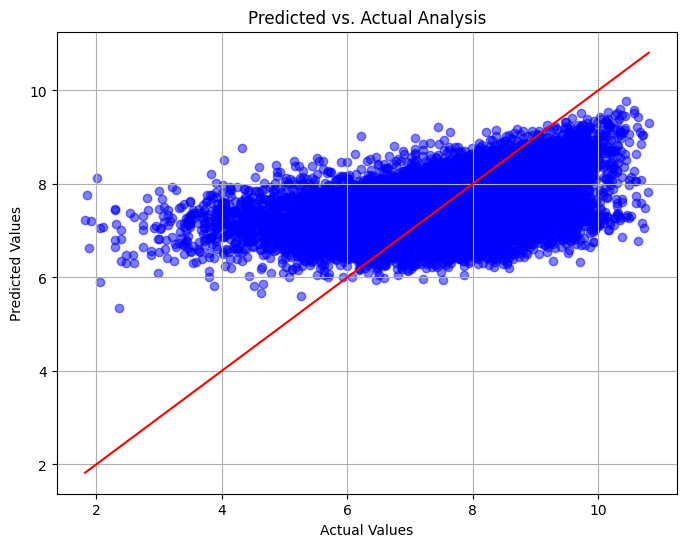

In [63]:
import matplotlib.pyplot as plt

# Assuming 'y_actual' contains the actual values and 'y_pred' contains the predicted values
plt.figure(figsize=(8, 6))
plt.scatter(y, y_pred, color='blue', alpha=0.5)
plt.plot([min(y), max(y)], [min(y), max(y)], color='red')  # Line of equality
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.title('Predicted vs. Actual Analysis')
plt.grid(True)
plt.show()


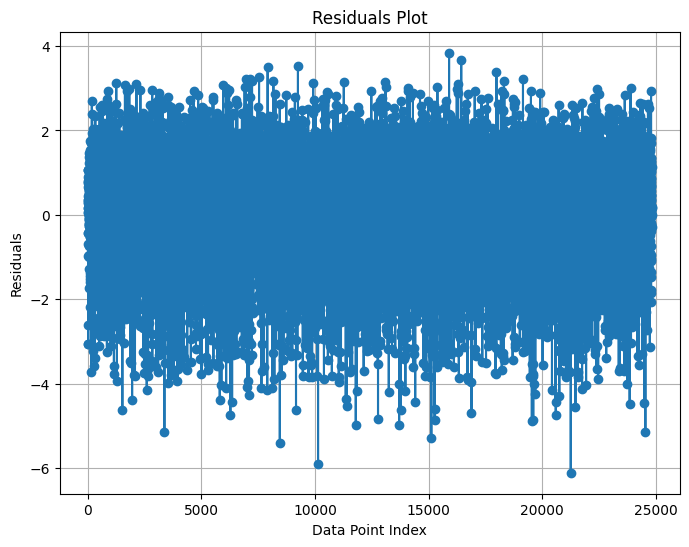

In [64]:
import matplotlib.pyplot as plt

# Assuming 'y_actual' contains the actual values and 'y_pred' contains the predicted values
residuals = y - y_pred

plt.figure(figsize=(8, 6))
plt.plot(range(len(residuals)), residuals, marker='o', linestyle='-')
plt.xlabel('Data Point Index')
plt.ylabel('Residuals')
plt.title('Residuals Plot')
plt.grid(True)
plt.show()
